# 15.5 Homework

In [5]:
from numpy import random

def dice_roll():
    die1= (random.randint(1,7)) #generate random number between 1 and 6
    die2= (random.randint(1,7)) #generate random number between 1 and 6
    print (die1,"and " + str(die2))
dice_roll()

2 and 3


In [6]:
def dice_roll(N0):
    
    N1= 0 #initialize starting point of how many double sixes are rolled
    
    for i in range(N0):
        die1=(random.randint(1,7)) #generate random number between 1 and 6
        die2= (random.randint(1,7)) #generate random number between 1 and 6
    
        if die1==6 and die2==6: 
            N1 +=1 #add to N1 if both dices roll a 6
    
    probability= N1/N0 #divide num of times 6,6 were rolled by the num of times dice were rolled
    
    print ("number of times double sixes were rolled:", N1)
    print ("number of times dice were rolled:", N0)
    print("Probability of rolling double sixes:", probability)

dice_roll(1000000) #roll dice a million times

number of times double sixes were rolled: 27684
number of times dice were rolled: 1000000
Probability of rolling double sixes: 0.027684


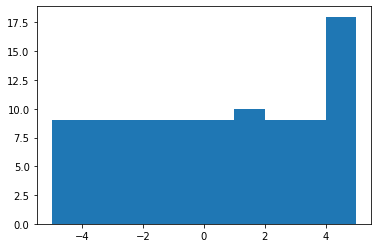

In [12]:
%matplotlib inline
import matplotlib.pyplot as plt

N = 100
a = 7**7 #large prime number
c = 0 
m = 17 #should usually use large prime number 
x = 1
results = []

for i in range(N):
    while True:
        x = (a*x+c) % m #use linear congruential generator formula to generate "random" number
        r = x - (m - (5 + 1)) #shift numbers so it will start from -5 instead of 1
        if r >= -5 and r <= 5: 
            results.append(r) #add to results list if number generated is between -5 and 5
            break
    
plt.hist(results)
plt.show()

# 14.4 Homework

Animation size has reached 20974809 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


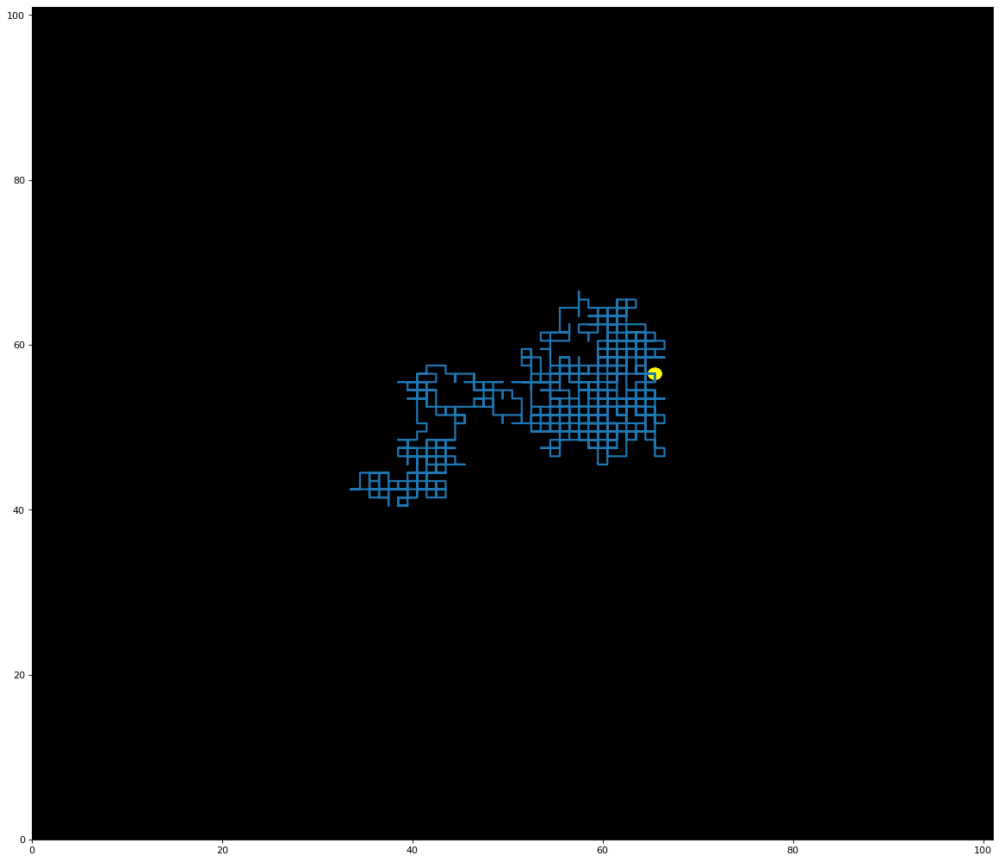

In [13]:
#brownian motion
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np

width = 101 #size of grid
height = 101 #size of grid 

fig = fig=plt.figure(figsize=(18, 16), dpi= 80) #set up parameters of the grid
ax = plt.axes(xlim=(0, width), ylim=(0, height))
ax.set_facecolor('black')
line, = ax.plot([], [], lw=2)
patch = plt.Circle((25, -25), 0.75, fc='#ffff00')

x_list = [] #store x values
y_list = [] #store y values

def init():
    line.set_data([], []) 
    patch.center = (0, 0)
    ax.add_patch(patch)
    return line,

def animate(i):
    if i == 0: #set up starting position of particle in the middle
        x_list.append(width/2)
        y_list.append(height/2)
    else:
        x=x_list[i-1]
        y=y_list[i-1]

        while True: #random walk. randomly choose if particle moves up, down, right, or left
            direction= np.random.choice(["up","down", "right","left"])
            m_x = 0
            m_y = 0
            if direction=="up":
                m_y += 1
            elif direction=="down":
                m_y -= 1
            elif direction=="right":
                m_x += 1
            else:
                m_x -= 1

            if x + m_x < 0 or x + m_x > width: #set up boundary conditions 
                continue
            if y + m_y < 0 or y + m_y > height:
                continue
            
            x += m_x
            y += m_y
            
            x_list.append(x)
            y_list.append(y)
            
            patch.center = (x, y)
            
            break
        
    line.set_data(x_list, y_list)
    return line, patch

#setup how many steps particle will take using frames and how long the particle will take to 
#get from one point to the next using interval 
anim = animation.FuncAnimation(fig, animate, init_func=init, 
                               frames=1500, interval=20, blit=True)

from IPython.display import HTML
HTML(anim.to_jshtml())

<function matplotlib.pyplot.show(*args, **kw)>

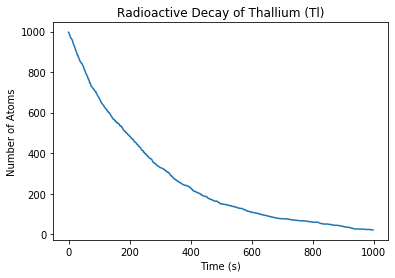

In [11]:
#radioactive decay 

import numpy as np
import matplotlib.pyplot as plt

tau= 3.064*60 #mean lifetime
N_atom=1000 #number of Thallium (Tl) atoms
N_time=1000 #time in seconds 
mu= np.log(2)/tau 
N_Tl= N_atom*np.ones([N_time-1]) #store number of decayed atoms

for i in range(N_atom):
    z= random.random() #generate random number
    x= int(-np.log(1-z)/mu) 
    if x<N_time:
        N_Tl[x:] -= 1

plt.plot(N_Tl)
plt.title("Radioactive Decay of Thallium (Tl)")
plt.xlabel("Time (s)")
plt.ylabel("Number of Atoms")
plt.show
    